# Sentiment Classification & How To "Frame Problems" for a Neural Network

by Andrew Trask

- **Twitter**: @iamtrask
- **Blog**: http://iamtrask.github.io

### What You Should Already Know

- neural networks, forward and back-propagation
- stochastic gradient descent
- mean squared error
- and train/test splits

### Where to Get Help if You Need it
- Re-watch previous Udacity Lectures
- Leverage the recommended Course Reading Material - [Grokking Deep Learning](https://www.manning.com/books/grokking-deep-learning) (Check inside your classroom for a discount code)
- Shoot me a tweet @iamtrask


### Tutorial Outline:

- Intro: The Importance of "Framing a Problem" (this lesson)

- [Curate a Dataset](#lesson_1)
- [Developing a "Predictive Theory"](#lesson_2)
- [**PROJECT 1**: Quick Theory Validation](#project_1)


- [Transforming Text to Numbers](#lesson_3)
- [**PROJECT 2**: Creating the Input/Output Data](#project_2)


- Putting it all together in a Neural Network (video only - nothing in notebook)
- [**PROJECT 3**: Building our Neural Network](#project_3)


- [Understanding Neural Noise](#lesson_4)
- [**PROJECT 4**: Making Learning Faster by Reducing Noise](#project_4)


- [Analyzing Inefficiencies in our Network](#lesson_5)
- [**PROJECT 5**: Making our Network Train and Run Faster](#project_5)


- [Further Noise Reduction](#lesson_6)
- [**PROJECT 6**: Reducing Noise by Strategically Reducing the Vocabulary](#project_6)


- [Analysis: What's going on in the weights?](#lesson_7)

# Lesson: Curate a Dataset<a id='lesson_1'></a>
The cells from here until Project 1 include code Andrew shows in the videos leading up to mini project 1. We've included them so you can run the code along with the videos without having to type in everything.

In [157]:
def pretty_print_review_and_label(i):
    print(labels[i] + "\t:\t" + reviews[i][:80] + "...")

g = open('reviews.txt','r') # What we know!
reviews = list(map(lambda x:x[:-1],g.readlines()))
g.close()

g = open('labels.txt','r') # What we WANT to know!
labels = list(map(lambda x:x[:-1].upper(),g.readlines()))
g.close()

**Note:** The data in `reviews.txt` we're using has already been preprocessed a bit and contains only lower case characters. If we were working from raw data, where we didn't know it was all lower case, we would want to add a step here to convert it. That's so we treat different variations of the same word, like `The`, `the`, and `THE`, all the same way.

In [158]:
len(reviews)

25000

In [159]:
reviews[0]

'bromwell high is a cartoon comedy . it ran at the same time as some other programs about school life  such as  teachers  . my   years in the teaching profession lead me to believe that bromwell high  s satire is much closer to reality than is  teachers  . the scramble to survive financially  the insightful students who can see right through their pathetic teachers  pomp  the pettiness of the whole situation  all remind me of the schools i knew and their students . when i saw the episode in which a student repeatedly tried to burn down the school  i immediately recalled . . . . . . . . . at . . . . . . . . . . high . a classic line inspector i  m here to sack one of your teachers . student welcome to bromwell high . i expect that many adults of my age think that bromwell high is far fetched . what a pity that it isn  t   '

In [160]:
labels[0]

'POSITIVE'

# Lesson: Develop a Predictive Theory<a id='lesson_2'></a>

In [161]:
print("labels.txt \t : \t reviews.txt\n")
pretty_print_review_and_label(2137)
pretty_print_review_and_label(12816)
pretty_print_review_and_label(6267)
pretty_print_review_and_label(21934)
pretty_print_review_and_label(5297)
pretty_print_review_and_label(4998)

labels.txt 	 : 	 reviews.txt

NEGATIVE	:	this movie is terrible but it has some good effects .  ...
POSITIVE	:	adrian pasdar is excellent is this film . he makes a fascinating woman .  ...
NEGATIVE	:	comment this movie is impossible . is terrible  very improbable  bad interpretat...
POSITIVE	:	excellent episode movie ala pulp fiction .  days   suicides . it doesnt get more...
NEGATIVE	:	if you haven  t seen this  it  s terrible . it is pure trash . i saw this about ...
POSITIVE	:	this schiffer guy is a real genius  the movie is of excellent quality and both e...


# Project 3: Building a Neural Network<a id='project_3'></a>

**TODO:** We've included the framework of a class called `SentimentNetork`. Implement all of the items marked `TODO` in the code. These include doing the following:
- Create a basic neural network much like the networks you've seen in earlier lessons and in Project 1, with an input layer, a hidden layer, and an output layer. 
- Do **not** add a non-linearity in the hidden layer. That is, do not use an activation function when calculating the hidden layer outputs.
- Re-use the code from earlier in this notebook to create the training data (see `TODO`s in the code)
- Implement the `pre_process_data` function to create the vocabulary for our training data generating functions
- Ensure `train` trains over the entire corpus

### Where to Get Help if You Need it
- Re-watch earlier Udacity lectures
- Chapters 3-5 - [Grokking Deep Learning](https://www.manning.com/books/grokking-deep-learning) - (Check inside your classroom for a discount code)

In [388]:
import time
import sys
import string
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1):
        # Assign a seed to our random number generator to ensure we get
        # reproducable results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):

        review_vocab = set()
        for review in reviews:
            words = review.split(' ')
            # convert to lower case
            tokens = [w.lower() for w in words]
            # remove punctuation from each word
            table = str.maketrans('', '', string.punctuation)
            stripped = [w.translate(table) for w in tokens]
            # remove remaining tokens that are not alphabetic
            words = [word for word in stripped if len(word)>1]

            for word in words:
                review_vocab.add(word)
        
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        label_vocab = set()
        for label in labels:
            label_vocab.add(label)
        
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        for i, word in enumerate(self.review_vocab):
            self.word2index[word] = i
        
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        for i, label in enumerate(self.label_vocab):
            self.label2index[label] = i
         
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes, self.hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0, self.hidden_nodes**-0.5, (self.hidden_nodes, self.output_nodes))
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_0 = np.zeros((1,input_nodes))
    
        
    def update_input_layer(self,review):
        # clear out previous state by resetting the layer to be all 0s
        self.layer_0 *= 0

        # TODO: count how many times each word is used in the given review and store the results in layer_0
        for word in review.split(' '):
            if(word in self.word2index.keys()):   
                self.layer_0[0][self.word2index[word]] += 1
                
    def get_target_for_label(self,label):
         if (label == "POSITIVE"):
            return 1
         if (label == "NEGATIVE"):
            return 0
        
    def sigmoid(self, x):
        return 1 / (1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self, output):
        return output * (1 - output)

    def train(self, training_reviews, training_labels):
        
        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0
        
        # Remember when we started for printing time statistics
        start = time.time()

        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            #### Implement the forward pass here ####
            ### Forward pass ###

            # Input Layer
            self.update_input_layer(review)

            # Hidden layer
            layer_1 = self.layer_0.dot(self.weights_0_1)

            # Output layer
            layer_2 = self.sigmoid(layer_1.dot(self.weights_1_2))
            
            #### Implement the backward pass here ####
            ### Backward pass ###

            # Output error
            layer_2_error = layer_2 - self.get_target_for_label(label) # Output layer error is the difference between desired target and actual output.
            layer_2_delta = layer_2_error * self.sigmoid_output_2_derivative(layer_2)

            # Backpropagated error
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T) # errors propagated to the hidden layer
            layer_1_delta = layer_1_error # hidden layer gradients - no nonlinearity so it's the same as the error

            # Update the weights
            self.weights_1_2 -= layer_1.T.dot(layer_2_delta) * self.learning_rate # update hidden-to-output weights with gradient descent step
            self.weights_0_1 -= self.layer_0.T.dot(layer_1_delta) * self.learning_rate # update input-to-hidden weights with gradient descent step

            # Keep track of correct predictions.
            if(layer_2 >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(layer_2 < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
        
        # input layer
        self.update_input_layer(review.lower())
            
        # hidden layer
        hidden_layer = np.dot(self.layer_0, self.weights_0_1)
            
        # output layer aka prediction
        output_layer = self.sigmoid(np.dot(hidden_layer, self.weights_1_2))

        if (output_layer[0] > 0.5):
            return 'POSITIVE'
        else:
            return 'NEGATIVE'

Run the following cell to actually train the network. During training, it will display the model's accuracy repeatedly as it trains so you can see how well it's doing.

In [399]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], hidden_nodes=10, learning_rate=0.008)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%
Progress:10.4% Speed(reviews/sec):158.4 #Correct:1674 #Trained:2501 Training Accuracy:66.9%
Progress:20.8% Speed(reviews/sec):157.7 #Correct:3533 #Trained:5001 Training Accuracy:70.6%
Progress:31.2% Speed(reviews/sec):157.6 #Correct:5482 #Trained:7501 Training Accuracy:73.0%
Progress:41.6% Speed(reviews/sec):157.3 #Correct:7486 #Trained:10001 Training Accuracy:74.8%
Progress:52.0% Speed(reviews/sec):157.2 #Correct:9510 #Trained:12501 Training Accuracy:76.0%
Progress:62.5% Speed(reviews/sec):156.9 #Correct:11505 #Trained:15001 Training Accuracy:76.6%
Progress:72.9% Speed(reviews/sec):156.6 #Correct:13472 #Trained:17501 Training Accuracy:76.9%
Progress:83.3% Speed(reviews/sec):156.3 #Correct:15530 #Trained:20001 Training Accuracy:77.6%
Progress:93.7% Speed(reviews/sec):156.3 #Correct:17613 #Trained:22501 Training Accuracy:78.2%
Progress:99.9% Speed(reviews/sec):156.2 #Correct:18871 #Trained:24000 Training 

In [337]:
mlp.run("amazing move with great actors good beautiful however the cgi was extremely bad")

'POSITIVE'

# Project 4: Reducing Noise in Our Input Data<a id='project_4'></a>

**TODO:** Attempt to reduce the noise in the input data like Andrew did in the previous video. Specifically, do the following:
* Copy the `SentimentNetwork` class you created earlier into the following cell.
* Modify `update_input_layer` so it does not count how many times each word is used, but rather just stores whether or not a word was used. 

In [400]:
import time
import sys
import string
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1):
        # Assign a seed to our random number generator to ensure we get
        # reproducable results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):

        review_vocab = set()
        for review in reviews:
            words = review.split(' ')
            # convert to lower case
            tokens = [w.lower() for w in words]
            # remove punctuation from each word
            table = str.maketrans('', '', string.punctuation)
            stripped = [w.translate(table) for w in tokens]
            # remove remaining tokens that are not alphabetic
            words = [word for word in stripped if len(word)>1]

            for word in words:
                review_vocab.add(word)
        
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        label_vocab = set()
        for label in labels:
            label_vocab.add(label)
        
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        for i, word in enumerate(self.review_vocab):
            self.word2index[word] = i
        
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        for i, label in enumerate(self.label_vocab):
            self.label2index[label] = i
         
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes, self.hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0, self.hidden_nodes**-0.5, (self.hidden_nodes, self.output_nodes))
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_0 = np.zeros((1,input_nodes))
    
        
    def update_input_layer(self,review):
        # clear out previous state by resetting the layer to be all 0s
        self.layer_0 *= 0

        # add if word was used
        for word in review.split(' '):
            if(word in self.word2index.keys()):   
                self.layer_0[0][self.word2index[word]] = 1
                
    def get_target_for_label(self,label):
         if (label == "POSITIVE"):
            return 1
         if (label == "NEGATIVE"):
            return 0
        
    def sigmoid(self, x):
        return 1 / (1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self, output):
        return output * (1 - output)

    def train(self, training_reviews, training_labels):
        
        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0
        
        # Remember when we started for printing time statistics
        start = time.time()

        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            #### Implement the forward pass here ####
            ### Forward pass ###

            # Input Layer
            self.update_input_layer(review)

            # Hidden layer
            layer_1 = self.layer_0.dot(self.weights_0_1)

            # Output layer
            layer_2 = self.sigmoid(layer_1.dot(self.weights_1_2))
            
            #### Implement the backward pass here ####
            ### Backward pass ###

            # Output error
            layer_2_error = layer_2 - self.get_target_for_label(label) # Output layer error is the difference between desired target and actual output.
            layer_2_delta = layer_2_error * self.sigmoid_output_2_derivative(layer_2)

            # Backpropagated error
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T) # errors propagated to the hidden layer
            layer_1_delta = layer_1_error # hidden layer gradients - no nonlinearity so it's the same as the error

            # Update the weights
            self.weights_1_2 -= layer_1.T.dot(layer_2_delta) * self.learning_rate # update hidden-to-output weights with gradient descent step
            self.weights_0_1 -= self.layer_0.T.dot(layer_1_delta) * self.learning_rate # update input-to-hidden weights with gradient descent step

            # Keep track of correct predictions.
            if(layer_2 >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(layer_2 < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
        
        # input layer
        self.update_input_layer(review.lower())
            
        # hidden layer
        hidden_layer = np.dot(self.layer_0, self.weights_0_1)
            
        # output layer aka prediction
        output_layer = self.sigmoid(np.dot(hidden_layer, self.weights_1_2))

        if (output_layer[0] > 0.5):
            return 'POSITIVE'
        else:
            return 'NEGATIVE'

Run the following cell to recreate the network and train it. Notice we've gone back to the higher learning rate of `0.1`.

In [404]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000],learning_rate=0.1)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%
Progress:10.4% Speed(reviews/sec):160.5 #Correct:1975 #Trained:2501 Training Accuracy:78.9%
Progress:20.8% Speed(reviews/sec):160.9 #Correct:4035 #Trained:5001 Training Accuracy:80.6%
Progress:31.2% Speed(reviews/sec):161.1 #Correct:6161 #Trained:7501 Training Accuracy:82.1%
Progress:41.6% Speed(reviews/sec):161.1 #Correct:8323 #Trained:10001 Training Accuracy:83.2%
Progress:52.0% Speed(reviews/sec):161.2 #Correct:10482 #Trained:12501 Training Accuracy:83.8%
Progress:62.5% Speed(reviews/sec):161.2 #Correct:12622 #Trained:15001 Training Accuracy:84.1%
Progress:72.9% Speed(reviews/sec):161.1 #Correct:14744 #Trained:17501 Training Accuracy:84.2%
Progress:83.3% Speed(reviews/sec):161.0 #Correct:16918 #Trained:20001 Training Accuracy:84.5%
Progress:93.7% Speed(reviews/sec):161.0 #Correct:19107 #Trained:22501 Training Accuracy:84.9%
Progress:99.9% Speed(reviews/sec):160.9 #Correct:20426 #Trained:24000 Training

That should have trained much better than the earlier attempts. It's still not wonderful, but it should have improved dramatically. Run the following cell to test your model with 1000 predictions.

In [406]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:34.3% Speed(reviews/sec):1910. #Correct:305 #Tested:344 Testing Accuracy:88.6%

Progress:72.3% Speed(reviews/sec):1969. #Correct:627 #Tested:724 Testing Accuracy:86.6%

Progress:99.9% Speed(reviews/sec):1971. #Correct:861 #Tested:1000 Testing Accuracy:86.1%

In [411]:
mlp.run("""How on earth a movie of this level have literally portraying no motive of kidnapping at all. Chris did his best !""")

'NEGATIVE'

In [412]:
mlp.run("""Look mate ... bangladesh is not kolkata .... here in each and every household we dont play hindi songs like you showed ... and dont get me started on the accent ... we dont talk in that accent dude.... thats kolkata accent .... also you couldnt have make the roads much more dirtier could you ? ...... just making some banners and some of our police dress doesn't make it bangladesh ........ you have shown a gangster of dhaka ... well gangster of dhaka doesnt live in old town . the only reference you have of bangladesh ... trust me ..... not offended or something.... just the cast of this movie have previously been in films where attention to details was a big matter ...... just one consultant from bangladesh would have clearerd out the problems ....... expectation was much higher""")

'NEGATIVE'

In [414]:
mlp.run("""Just in short, over hyped movie. Storyline too much poor, if you just exclude Chris from the cast, it doesn't even worth watching""")

'NEGATIVE'

In [415]:
mlp.run("""First of all this movie is for entertainment so don't give negative comments on the basis of bangladeshi image. Its a fun action ride so enjoy and don't miss this flick. This netflix movie is mindblowing and interesting,i will mention both positive and negative points of this movie:- Positive:- 1). Action and fight sequences 2). Acting and performance by both actors Chris n Randeep. 3). Screenplay 4). Direction 5). Fast Storyline

Negative- 1)- Plot(because only one thing i can't understand that how army of an country work under a drug lord and lock down capital on the order of drug lord?)
But overall movie is worth watching and don't think about negative comments because its just a one sided.""")

'POSITIVE'

# Project 5: Making our Network More Efficient<a id='project_5'></a>
**TODO:** Make the `SentimentNetwork` class more efficient by eliminating unnecessary multiplications and additions that occur during forward and backward propagation. To do that, you can do the following:
* Copy the `SentimentNetwork` class from the previous project into the following cell.
* Remove the `update_input_layer` function - you will not need it in this version.
* Modify `init_network`:
>* You no longer need a separate input layer, so remove any mention of `self.layer_0`
>* You will be dealing with the old hidden layer more directly, so create `self.layer_1`, a two-dimensional matrix with shape 1 x hidden_nodes, with all values initialized to zero
* Modify `train`:
>* Change the name of the input parameter `training_reviews` to `training_reviews_raw`. This will help with the next step.
>* At the beginning of the function, you'll want to preprocess your reviews to convert them to a list of indices (from `word2index`) that are actually used in the review. This is equivalent to what you saw in the video when Andrew set specific indices to 1. Your code should create a local `list` variable named `training_reviews` that should contain a `list` for each review in `training_reviews_raw`. Those lists should contain the indices for words found in the review.
>* Remove call to `update_input_layer`
>* Use `self`'s  `layer_1` instead of a local `layer_1` object.
>* In the forward pass, replace the code that updates `layer_1` with new logic that only adds the weights for the indices used in the review.
>* When updating `weights_0_1`, only update the individual weights that were used in the forward pass.
* Modify `run`:
>* Remove call to `update_input_layer` 
>* Use `self`'s  `layer_1` instead of a local `layer_1` object.
>* Much like you did in `train`, you will need to pre-process the `review` so you can work with word indices, then update `layer_1` by adding weights for the indices used in the review.

In [435]:
import time
import sys
import string
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1):
        np.random.seed(1)
        self.pre_process_data(reviews, labels)
        
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):

        review_vocab = set()
        for review in reviews:
            words = review.split(' ')
            # convert to lower case
            tokens = [w.lower() for w in words]
            # remove punctuation from each word
            table = str.maketrans('', '', string.punctuation)
            stripped = [w.translate(table) for w in tokens]
            # remove remaining tokens that are not alphabetic
            words = [word for word in stripped if len(word)>1]

            for word in words:
                review_vocab.add(word)
        
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        label_vocab = set()
        for label in labels:
            label_vocab.add(label)
        
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        for i, word in enumerate(self.review_vocab):
            self.word2index[word] = i
        
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        for i, label in enumerate(self.label_vocab):
            self.label2index[label] = i
         
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes, self.hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0, self.hidden_nodes**-0.5, (self.hidden_nodes, self.output_nodes))
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_1 = np.zeros((1,hidden_nodes))
                
    def get_target_for_label(self,label):
         if (label == "POSITIVE"):
            return 1
         if (label == "NEGATIVE"):
            return 0
        
    def sigmoid(self, x):
        return 1 / (1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self, output):
        return output * (1 - output)

    def train(self, training_reviews_raw, training_labels):
        training_reviews = list()
        for review in training_reviews_raw:
            indices = set()
            for word in review.split(" "):
                if(word in self.word2index.keys()):
                    indices.add(self.word2index[word])
            training_reviews.append(list(indices))

        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0

        # Remember when we started for printing time statistics
        start = time.time()
        
        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            ### Forward pass ###

            # Hidden layer
            self.layer_1 *= 0
            for index in review:
                self.layer_1 += self.weights_0_1[index]

            # Output layer
            layer_2 = self.sigmoid(self.layer_1.dot(self.weights_1_2))            
            
            ### Backward pass ###

            # Output error
            layer_2_error = layer_2 - self.get_target_for_label(label) # Output layer error is the difference between desired target and actual output.
            layer_2_delta = layer_2_error * self.sigmoid_output_2_derivative(layer_2)

            # Backpropagated error
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T) # errors propagated to the hidden layer
            layer_1_delta = layer_1_error # hidden layer gradients - no nonlinearity so it's the same as the error

            # Update the weights
            self.weights_1_2 -= self.layer_1.T.dot(layer_2_delta) * self.learning_rate # update hidden-to-output weights with gradient descent step
            
            ## New for Project 5: Only update the weights that were used in the forward pass
            for index in review:
                self.weights_0_1[index] -= layer_1_delta[0] * self.learning_rate # update input-to-hidden weights with gradient descent step

            # Keep track of correct predictions.
            if(layer_2 >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(layer_2 < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 
            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(elapsed_time % 500 == 0):
                print("")
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
            
        # hidden layer
        self.layer_1 *= 0
        unique_indices = set()
        for word in review.lower().split(" "):
            if word in self.word2index.keys():
                unique_indices.add(self.word2index[word])
        for index in unique_indices:
            self.layer_1 += self.weights_0_1[index]
            
        # output layer aka prediction
        output_layer = self.sigmoid(np.dot(self.layer_1, self.weights_1_2))

        if (output_layer[0] > 0.5):
            return 'POSITIVE'
        else:
            return 'NEGATIVE'

Run the following cell to recreate the network and train it once again.

In [436]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000],learning_rate=0.1)
mlp.train(reviews[:-1000] * 3,labels[:-1000] * 3)

Progress:0.0% Speed(reviews/sec):0 #Correct:1 #Trained:1 Training Accuracy:100.%


Progress:1.12% Speed(reviews/sec):2109. #Correct:604 #Trained:809 Training Accuracy:74.6%

Progress:1.68% Speed(reviews/sec):2120. #Correct:936 #Trained:1211 Training Accuracy:77.2%

Progress:2.26% Speed(reviews/sec):2148. #Correct:1262 #Trained:1630 Training Accuracy:77.4%

Progress:2.88% Speed(reviews/sec):2196. #Correct:1626 #Trained:2078 Training Accuracy:78.2%

Progress:3.43% Speed(reviews/sec):2174. #Correct:1951 #Trained:2474 Training Accuracy:78.8%

Progress:3.96% Speed(reviews/sec):2163. #Correct:2290 #Trained:2858 Training Accuracy:80.1%

Progress:4.51% Speed(reviews/sec):2154. #Correct:2615 #Trained:3252 Training Accuracy:80.4%

Progress:5.09% Speed(reviews/sec):2148. #Correct:2938 #Trained:3669 Training Accuracy:80.0%

Progress:5.61% Speed(reviews/sec):2148. #Correct:3256 #Trained:4046 Training Accuracy:80.4%

Progress:6.21% Speed(reviews/sec):2145. #Correct:3607 #Trained:4475 Training Accuracy:80.6%

Progress:6.72% Speed(reviews/sec):2131. #Correct:3913 #Trained:4846 Training Accuracy:80.7%

Progress:7.26% Speed(reviews/sec):2125. #Correct:4236 #Trained:5232 Training Accuracy:80.9%

Progress:7.84% Speed(reviews/sec):2132. #Correct:4582 #Trained:5651 Training Accuracy:81.0%

Progress:8.36% Speed(reviews/sec):2123. #Correct:4890 #Trained:6021 Training Accuracy:81.2%

Progress:8.89% Speed(reviews/sec):2119. #Correct:5219 #Trained:6407 Training Accuracy:81.4%

Progress:9.45% Speed(reviews/sec):2121. #Correct:5569 #Trained:6812 Training Accuracy:81.7%

Progress:10.0% Speed(reviews/sec):2119. #Correct:5915 #Trained:7205 Training Accuracy:82.0%

Progress:10.5% Speed(reviews/sec):2118. #Correct:6246 #Trained:7598 Training Accuracy:82.2%

Progress:11.1% Speed(reviews/sec):2123. #Correct:6604 #Trained:8015 Training Accuracy:82.3%

Progress:11.6% Speed(reviews/sec):2122. #Correct:6942 #Trained:8410 Training Accuracy:82.5%

Progress:12.2% Speed(reviews/sec):2121. #Correct:7270 #Trained:8800 Training Accuracy:82.6%

Progress:12.7% Speed(reviews/sec):2111. #Correct:7589 #Trained:9154 Training Accuracy:82.9%

Progress:13.2% Speed(reviews/sec):2104. #Correct:7914 #Trained:9529 Training Accuracy:83.0%

Progress:13.8% Speed(reviews/sec):2110. #Correct:8273 #Trained:9943 Training Accuracy:83.2%

Progress:14.3% Speed(reviews/sec):2105. #Correct:8596 #Trained:10316 Training Accuracy:83.3%

Progress:14.8% Speed(reviews/sec):2102. #Correct:8919 #Trained:10691 Training Accuracy:83.4%

Progress:15.3% Speed(reviews/sec):2101. #Correct:9254 #Trained:11083 Training Accuracy:83.4%

Progress:15.9% Speed(reviews/sec):2099. #Correct:9574 #Trained:11465 Training Accuracy:83.5%

Progress:16.4% Speed(reviews/sec):2096. #Correct:9909 #Trained:11845 Training Accuracy:83.6%

Progress:17.0% Speed(reviews/sec):2098. #Correct:10257 #Trained:12247 Training Accuracy:83.7%

Progress:17.5% Speed(reviews/sec):2099. #Correct:10612 #Trained:12647 Training Accuracy:83.9%

Progress:18.1% Speed(reviews/sec):2099. #Correct:10945 #Trained:13040 Training Accuracy:83.9%

Progress:18.6% Speed(reviews/sec):2104. #Correct:11307 #Trained:13463 Training Accuracy:83.9%

Progress:19.2% Speed(reviews/sec):2101. #Correct:11639 #Trained:13842 Training Accuracy:84.0%

Progress:19.8% Speed(reviews/sec):2105. #Correct:12003 #Trained:14263 Training Accuracy:84.1%

Progress:20.4% Speed(reviews/sec):2110. #Correct:12352 #Trained:14691 Training Accuracy:84.0%

Progress:20.9% Speed(reviews/sec):2105. #Correct:12668 #Trained:15058 Training Accuracy:84.1%

Progress:21.4% Speed(reviews/sec):2104. #Correct:13015 #Trained:15473 Training Accuracy:84.1%

Progress:22.0% Speed(reviews/sec):2107. #Correct:13373 #Trained:15895 Training Accuracy:84.1%

Progress:22.6% Speed(reviews/sec):2106. #Correct:13701 #Trained:16280 Training Accuracy:84.1%

Progress:23.1% Speed(reviews/sec):2103. #Correct:14011 #Trained:16650 Training Accuracy:84.1%

Progress:23.6% Speed(reviews/sec):2105. #Correct:14359 #Trained:17061 Training Accuracy:84.1%

Progress:24.2% Speed(reviews/sec):2102. #Correct:14679 #Trained:17428 Training Accuracy:84.2%

Progress:24.7% Speed(reviews/sec):2101. #Correct:15008 #Trained:17813 Training Accuracy:84.2%

Progress:25.2% Speed(reviews/sec):2101. #Correct:15358 #Trained:18212 Training Accuracy:84.3%

Progress:25.7% Speed(reviews/sec):2097. #Correct:15668 #Trained:18569 Training Accuracy:84.3%

Progress:26.3% Speed(reviews/sec):2099. #Correct:16034 #Trained:18980 Training Accuracy:84.4%

Progress:27.0% Speed(reviews/sec):2100. #Correct:16472 #Trained:19480 Training Accuracy:84.5%

Progress:27.5% Speed(reviews/sec):2099. #Correct:16798 #Trained:19863 Training Accuracy:84.5%

Progress:28.1% Speed(reviews/sec):2096. #Correct:17134 #Trained:20245 Training Accuracy:84.6%

Progress:28.5% Speed(reviews/sec):2092. #Correct:17425 #Trained:20578 Training Accuracy:84.6%

Progress:29.1% Speed(reviews/sec):2091. #Correct:17761 #Trained:20963 Training Accuracy:84.7%

Progress:29.6% Speed(reviews/sec):2093. #Correct:18124 #Trained:21374 Training Accuracy:84.7%

Progress:30.2% Speed(reviews/sec):2094. #Correct:18482 #Trained:21783 Training Accuracy:84.8%

Progress:30.8% Speed(reviews/sec):2095. #Correct:18829 #Trained:22179 Training Accuracy:84.8%

Progress:31.3% Speed(reviews/sec):2093. #Correct:19150 #Trained:22560 Training Accuracy:84.8%

Progress:31.8% Speed(reviews/sec):2095. #Correct:19503 #Trained:22968 Training Accuracy:84.9%

Progress:32.4% Speed(reviews/sec):2095. #Correct:19840 #Trained:23362 Training Accuracy:84.9%

Progress:32.9% Speed(reviews/sec):2094. #Correct:20194 #Trained:23747 Training Accuracy:85.0%

Progress:33.5% Speed(reviews/sec):2094. #Correct:20551 #Trained:24142 Training Accuracy:85.1%

Progress:34.0% Speed(reviews/sec):2095. #Correct:20921 #Trained:24546 Training Accuracy:85.2%

Progress:34.6% Speed(reviews/sec):2096. #Correct:21292 #Trained:24946 Training Accuracy:85.3%

Progress:35.2% Speed(reviews/sec):2098. #Correct:21665 #Trained:25357 Training Accuracy:85.4%

Progress:35.8% Speed(reviews/sec):2100. #Correct:22054 #Trained:25783 Training Accuracy:85.5%

Progress:36.3% Speed(reviews/sec):2100. #Correct:22422 #Trained:26179 Training Accuracy:85.6%

Progress:36.8% Speed(reviews/sec):2097. #Correct:22746 #Trained:26535 Training Accuracy:85.7%

Progress:37.3% Speed(reviews/sec):2095. #Correct:23088 #Trained:26900 Training Accuracy:85.8%

Progress:37.8% Speed(reviews/sec):2095. #Correct:23440 #Trained:27286 Training Accuracy:85.9%

Progress:38.3% Speed(reviews/sec):2092. #Correct:23754 #Trained:27642 Training Accuracy:85.9%

Progress:38.9% Speed(reviews/sec):2091. #Correct:24091 #Trained:28018 Training Accuracy:85.9%

Progress:39.4% Speed(reviews/sec):2091. #Correct:24454 #Trained:28412 Training Accuracy:86.0%

Progress:39.9% Speed(reviews/sec):2088. #Correct:24775 #Trained:28769 Training Accuracy:86.1%

Progress:40.4% Speed(reviews/sec):2086. #Correct:25092 #Trained:29131 Training Accuracy:86.1%

Progress:41.0% Speed(reviews/sec):2087. #Correct:25450 #Trained:29530 Training Accuracy:86.1%

Progress:41.5% Speed(reviews/sec):2085. #Correct:25793 #Trained:29914 Training Accuracy:86.2%

Progress:42.0% Speed(reviews/sec):2084. #Correct:26117 #Trained:30274 Training Accuracy:86.2%

Progress:42.5% Speed(reviews/sec):2084. #Correct:26472 #Trained:30668 Training Accuracy:86.3%

Progress:43.1% Speed(reviews/sec):2083. #Correct:26813 #Trained:31043 Training Accuracy:86.3%

Progress:43.6% Speed(reviews/sec):2081. #Correct:27147 #Trained:31408 Training Accuracy:86.4%

Progress:44.1% Speed(reviews/sec):2082. #Correct:27520 #Trained:31813 Training Accuracy:86.5%

Progress:44.7% Speed(reviews/sec):2083. #Correct:27881 #Trained:32210 Training Accuracy:86.5%

Progress:45.2% Speed(reviews/sec):2082. #Correct:28222 #Trained:32588 Training Accuracy:86.6%

Progress:45.7% Speed(reviews/sec):2081. #Correct:28567 #Trained:32975 Training Accuracy:86.6%

Progress:46.3% Speed(reviews/sec):2082. #Correct:28941 #Trained:33372 Training Accuracy:86.7%

Progress:46.9% Speed(reviews/sec):2082. #Correct:29307 #Trained:33770 Training Accuracy:86.7%

Progress:47.4% Speed(reviews/sec):2083. #Correct:29680 #Trained:34189 Training Accuracy:86.8%

Progress:47.9% Speed(reviews/sec):2082. #Correct:30009 #Trained:34547 Training Accuracy:86.8%

Progress:48.5% Speed(reviews/sec):2082. #Correct:30355 #Trained:34932 Training Accuracy:86.8%

Progress:49.0% Speed(reviews/sec):2081. #Correct:30720 #Trained:35335 Training Accuracy:86.9%

Progress:49.6% Speed(reviews/sec):2082. #Correct:31098 #Trained:35748 Training Accuracy:86.9%

Progress:50.1% Speed(reviews/sec):2082. #Correct:31447 #Trained:36131 Training Accuracy:87.0%

Progress:50.7% Speed(reviews/sec):2083. #Correct:31817 #Trained:36541 Training Accuracy:87.0%

Progress:51.2% Speed(reviews/sec):2083. #Correct:32167 #Trained:36929 Training Accuracy:87.1%

Progress:51.8% Speed(reviews/sec):2084. #Correct:32544 #Trained:37349 Training Accuracy:87.1%

Progress:52.4% Speed(reviews/sec):2084. #Correct:32895 #Trained:37736 Training Accuracy:87.1%

Progress:52.9% Speed(reviews/sec):2084. #Correct:33260 #Trained:38130 Training Accuracy:87.2%

Progress:53.5% Speed(reviews/sec):2085. #Correct:33613 #Trained:38527 Training Accuracy:87.2%

Progress:54.0% Speed(reviews/sec):2084. #Correct:33963 #Trained:38911 Training Accuracy:87.2%

Progress:54.5% Speed(reviews/sec):2083. #Correct:34295 #Trained:39276 Training Accuracy:87.3%

Progress:55.0% Speed(reviews/sec):2082. #Correct:34631 #Trained:39652 Training Accuracy:87.3%

Progress:55.6% Speed(reviews/sec):2083. #Correct:34981 #Trained:40056 Training Accuracy:87.3%

Progress:56.1% Speed(reviews/sec):2083. #Correct:35334 #Trained:40450 Training Accuracy:87.3%

Progress:56.6% Speed(reviews/sec):2081. #Correct:35660 #Trained:40807 Training Accuracy:87.3%

Progress:57.3% Speed(reviews/sec):2083. #Correct:36076 #Trained:41264 Training Accuracy:87.4%

Progress:57.8% Speed(reviews/sec):2082. #Correct:36407 #Trained:41631 Training Accuracy:87.4%

Progress:58.3% Speed(reviews/sec):2081. #Correct:36752 #Trained:42003 Training Accuracy:87.4%

Progress:58.8% Speed(reviews/sec):2081. #Correct:37106 #Trained:42394 Training Accuracy:87.5%

Progress:59.3% Speed(reviews/sec):2080. #Correct:37459 #Trained:42768 Training Accuracy:87.5%

Progress:59.9% Speed(reviews/sec):2080. #Correct:37808 #Trained:43148 Training Accuracy:87.6%

Progress:60.4% Speed(reviews/sec):2079. #Correct:38154 #Trained:43524 Training Accuracy:87.6%

Progress:60.9% Speed(reviews/sec):2078. #Correct:38478 #Trained:43883 Training Accuracy:87.6%

Progress:61.4% Speed(reviews/sec):2076. #Correct:38811 #Trained:44244 Training Accuracy:87.7%

Progress:61.9% Speed(reviews/sec):2074. #Correct:39115 #Trained:44582 Training Accuracy:87.7%

Progress:62.4% Speed(reviews/sec):2073. #Correct:39455 #Trained:44961 Training Accuracy:87.7%

Progress:62.9% Speed(reviews/sec):2073. #Correct:39811 #Trained:45349 Training Accuracy:87.7%

Progress:63.5% Speed(reviews/sec):2073. #Correct:40150 #Trained:45724 Training Accuracy:87.8%

Progress:64.0% Speed(reviews/sec):2073. #Correct:40506 #Trained:46121 Training Accuracy:87.8%

Progress:64.5% Speed(reviews/sec):2071. #Correct:40838 #Trained:46484 Training Accuracy:87.8%

Progress:65.1% Speed(reviews/sec):2072. #Correct:41183 #Trained:46879 Training Accuracy:87.8%

Progress:65.6% Speed(reviews/sec):2072. #Correct:41531 #Trained:47265 Training Accuracy:87.8%

Progress:66.1% Speed(reviews/sec):2072. #Correct:41882 #Trained:47648 Training Accuracy:87.8%

Progress:66.7% Speed(reviews/sec):2071. #Correct:42243 #Trained:48028 Training Accuracy:87.9%

Progress:67.2% Speed(reviews/sec):2072. #Correct:42615 #Trained:48429 Training Accuracy:87.9%

Progress:67.8% Speed(reviews/sec):2072. #Correct:42985 #Trained:48824 Training Accuracy:88.0%

Progress:68.3% Speed(reviews/sec):2073. #Correct:43366 #Trained:49227 Training Accuracy:88.0%

Progress:68.9% Speed(reviews/sec):2074. #Correct:43759 #Trained:49651 Training Accuracy:88.1%

Progress:69.5% Speed(reviews/sec):2077. #Correct:44185 #Trained:50101 Training Accuracy:88.1%

Progress:70.0% Speed(reviews/sec):2076. #Correct:44530 #Trained:50469 Training Accuracy:88.2%

Progress:70.5% Speed(reviews/sec):2075. #Correct:44873 #Trained:50832 Training Accuracy:88.2%

Progress:71.1% Speed(reviews/sec):2074. #Correct:45228 #Trained:51204 Training Accuracy:88.3%

Progress:71.6% Speed(reviews/sec):2074. #Correct:45591 #Trained:51593 Training Accuracy:88.3%

Progress:72.2% Speed(reviews/sec):2075. #Correct:45958 #Trained:51995 Training Accuracy:88.3%

Progress:72.7% Speed(reviews/sec):2075. #Correct:46333 #Trained:52396 Training Accuracy:88.4%

Progress:73.2% Speed(reviews/sec):2075. #Correct:46689 #Trained:52771 Training Accuracy:88.4%

Progress:73.8% Speed(reviews/sec):2074. #Correct:47038 #Trained:53156 Training Accuracy:88.4%

Progress:74.4% Speed(reviews/sec):2075. #Correct:47423 #Trained:53572 Training Accuracy:88.5%

Progress:74.9% Speed(reviews/sec):2076. #Correct:47785 #Trained:53964 Training Accuracy:88.5%

Progress:75.4% Speed(reviews/sec):2076. #Correct:48148 #Trained:54357 Training Accuracy:88.5%

Progress:76.0% Speed(reviews/sec):2076. #Correct:48527 #Trained:54765 Training Accuracy:88.6%

Progress:76.5% Speed(reviews/sec):2076. #Correct:48884 #Trained:55148 Training Accuracy:88.6%

Progress:77.1% Speed(reviews/sec):2077. #Correct:49275 #Trained:55563 Training Accuracy:88.6%

Progress:77.7% Speed(reviews/sec):2078. #Correct:49667 #Trained:55982 Training Accuracy:88.7%

Progress:78.3% Speed(reviews/sec):2079. #Correct:50053 #Trained:56400 Training Accuracy:88.7%

Progress:78.8% Speed(reviews/sec):2080. #Correct:50418 #Trained:56805 Training Accuracy:88.7%

Progress:79.4% Speed(reviews/sec):2080. #Correct:50799 #Trained:57203 Training Accuracy:88.8%

Progress:80.0% Speed(reviews/sec):2081. #Correct:51187 #Trained:57614 Training Accuracy:88.8%

Progress:80.5% Speed(reviews/sec):2082. #Correct:51578 #Trained:58031 Training Accuracy:88.8%

Progress:81.1% Speed(reviews/sec):2082. #Correct:51943 #Trained:58423 Training Accuracy:88.9%

Progress:81.6% Speed(reviews/sec):2082. #Correct:52308 #Trained:58810 Training Accuracy:88.9%

Progress:82.2% Speed(reviews/sec):2082. #Correct:52684 #Trained:59215 Training Accuracy:88.9%

Progress:82.8% Speed(reviews/sec):2083. #Correct:53054 #Trained:59620 Training Accuracy:88.9%

Progress:83.3% Speed(reviews/sec):2082. #Correct:53406 #Trained:59996 Training Accuracy:89.0%

Progress:83.9% Speed(reviews/sec):2083. #Correct:53790 #Trained:60409 Training Accuracy:89.0%

Progress:84.4% Speed(reviews/sec):2083. #Correct:54152 #Trained:60786 Training Accuracy:89.0%

Progress:84.9% Speed(reviews/sec):2083. #Correct:54523 #Trained:61189 Training Accuracy:89.1%

Progress:85.5% Speed(reviews/sec):2083. #Correct:54893 #Trained:61585 Training Accuracy:89.1%

Progress:86.0% Speed(reviews/sec):2084. #Correct:55278 #Trained:61992 Training Accuracy:89.1%

Progress:86.6% Speed(reviews/sec):2085. #Correct:55660 #Trained:62408 Training Accuracy:89.1%

Progress:87.2% Speed(reviews/sec):2085. #Correct:56034 #Trained:62817 Training Accuracy:89.2%

Progress:87.7% Speed(reviews/sec):2085. #Correct:56376 #Trained:63191 Training Accuracy:89.2%

Progress:88.2% Speed(reviews/sec):2084. #Correct:56739 #Trained:63576 Training Accuracy:89.2%

Progress:88.8% Speed(reviews/sec):2085. #Correct:57096 #Trained:63987 Training Accuracy:89.2%

Progress:89.4% Speed(reviews/sec):2085. #Correct:57447 #Trained:64375 Training Accuracy:89.2%

Progress:89.9% Speed(reviews/sec):2085. #Correct:57808 #Trained:64759 Training Accuracy:89.2%

Progress:90.5% Speed(reviews/sec):2087. #Correct:58227 #Trained:65210 Training Accuracy:89.2%

Progress:91.0% Speed(reviews/sec):2086. #Correct:58577 #Trained:65592 Training Accuracy:89.3%

Progress:91.6% Speed(reviews/sec):2086. #Correct:58928 #Trained:65967 Training Accuracy:89.3%

Progress:92.1% Speed(reviews/sec):2086. #Correct:59290 #Trained:66354 Training Accuracy:89.3%

Progress:92.6% Speed(reviews/sec):2085. #Correct:59656 #Trained:66737 Training Accuracy:89.3%

Progress:93.2% Speed(reviews/sec):2085. #Correct:60009 #Trained:67110 Training Accuracy:89.4%

Progress:93.7% Speed(reviews/sec):2084. #Correct:60396 #Trained:67524 Training Accuracy:89.4%

Progress:94.2% Speed(reviews/sec):2084. #Correct:60735 #Trained:67889 Training Accuracy:89.4%

Progress:94.7% Speed(reviews/sec):2082. #Correct:61044 #Trained:68222 Training Accuracy:89.4%

Progress:95.2% Speed(reviews/sec):2081. #Correct:61389 #Trained:68592 Training Accuracy:89.4%

Progress:95.7% Speed(reviews/sec):2081. #Correct:61721 #Trained:68953 Training Accuracy:89.5%

Progress:96.2% Speed(reviews/sec):2080. #Correct:62084 #Trained:69332 Training Accuracy:89.5%

Progress:96.8% Speed(reviews/sec):2080. #Correct:62444 #Trained:69717 Training Accuracy:89.5%

Progress:97.3% Speed(reviews/sec):2080. #Correct:62805 #Trained:70110 Training Accuracy:89.5%

Progress:97.8% Speed(reviews/sec):2079. #Correct:63142 #Trained:70468 Training Accuracy:89.6%

Progress:98.3% Speed(reviews/sec):2079. #Correct:63483 #Trained:70848 Training Accuracy:89.6%

Progress:98.9% Speed(reviews/sec):2079. #Correct:63838 #Trained:71232 Training Accuracy:89.6%

Progress:99.4% Speed(reviews/sec):2078. #Correct:64180 #Trained:71602 Training Accuracy:89.6%

Progress:99.9% Speed(reviews/sec):2078. #Correct:64534 #Trained:71967 Training Accuracy:89.6%

Progress:99.9% Speed(reviews/sec):2077. #Correct:64564 #Trained:72000 Training Accuracy:89.6%

That should have trained much better than the earlier attempts. Run the following cell to test your model with 1000 predictions.

In [433]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:70.8% Speed(reviews/sec):3585. #Correct:616 #Tested:709 Testing Accuracy:86.8%

Progress:99.9% Speed(reviews/sec):3629. #Correct:861 #Tested:1000 Testing Accuracy:86.1%

# End of Project 5. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.
# Further Noise Reduction<a id='lesson_6'></a>

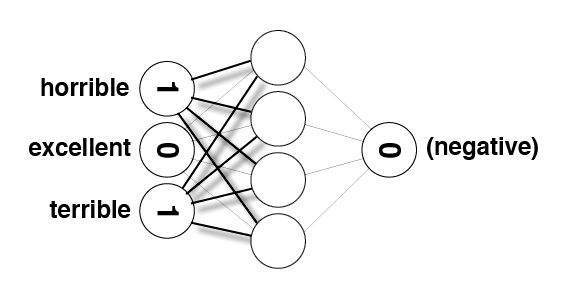

In [437]:
Image(filename='sentiment_network_sparse_2.png')

In [438]:
# words most frequently seen in a review with a "POSITIVE" label
pos_neg_ratios.most_common()

[('edie', 4.6913478822291435),
 ('paulie', 4.07753744390572),
 ('felix', 3.152736022363656),
 ('polanski', 2.8233610476132043),
 ('matthau', 2.80672172860924),
 ('victoria', 2.681021528714291),
 ('mildred', 2.6026896854443837),
 ('gandhi', 2.538973871058276),
 ('flawless', 2.451005098112319),
 ('superbly', 2.26002547857525),
 ('perfection', 2.159484249353372),
 ('astaire', 2.1400661634962708),
 ('captures', 2.038619547159581),
 ('voight', 2.030170492673053),
 ('wonderfully', 2.0218960560332353),
 ('powell', 1.978345424808467),
 ('brosnan', 1.9547990964725592),
 ('lily', 1.9203768470501485),
 ('bakshi', 1.9029851043382795),
 ('lincoln', 1.9014583864844796),
 ('refreshing', 1.8551812956655511),
 ('breathtaking', 1.8481124057791867),
 ('bourne', 1.8478489358790986),
 ('lemmon', 1.8458266904983307),
 ('delightful', 1.8002701588959635),
 ('flynn', 1.7996646487351682),
 ('andrews', 1.7764919970972666),
 ('homer', 1.7692866133759964),
 ('beautifully', 1.7626953362841438),
 ('soccer', 1.757857

In [439]:
# words most frequently seen in a review with a "NEGATIVE" label
list(reversed(pos_neg_ratios.most_common()))[0:30]

[('boll', -4.07781526027089),
 ('uwe', -3.921875301871158),
 ('seagal', -3.320250105858192),
 ('unwatchable', -3.0269848170580955),
 ('stinker', -2.9876839403711624),
 ('mst', -2.775383321170797),
 ('incoherent', -2.7641396677532537),
 ('unfunny', -2.5545257844967644),
 ('waste', -2.4907515123361046),
 ('blah', -2.4475792789485005),
 ('horrid', -2.371577964480997),
 ('pointless', -2.345107387713634),
 ('atrocious', -2.3187369339642556),
 ('redeeming', -2.2667790015910296),
 ('prom', -2.2601040980178784),
 ('drivel', -2.247602958576693),
 ('lousy', -2.2118080125207054),
 ('worst', -2.1930856334332267),
 ('laughable', -2.172468615469592),
 ('awful', -2.1385076866397488),
 ('poorly', -2.132613384420701),
 ('wasting', -2.117815554561451),
 ('remotely', -2.111046881095167),
 ('existent', -2.0024805005437076),
 ('boredom', -1.9241486572738005),
 ('miserably', -1.921661093801999),
 ('sucks', -1.9166645809588516),
 ('uninspired', -1.9131499212248517),
 ('lame', -1.9117232884159072),
 ('insult'

In [441]:
from bokeh.models import ColumnDataSource, LabelSet
from bokeh.plotting import figure, show, output_file
from bokeh.io import output_notebook
output_notebook()

Loading BokehJS ...

In [442]:
hist, edges = np.histogram(list(map(lambda x:x[1],pos_neg_ratios.most_common())), density=True, bins=100, normed=True)

p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="Word Positive/Negative Affinity Distribution")
p.quad(top=hist, bottom=0, left=edges[:-1], right=edges[1:], line_color="#555555")
show(p)

C:\Users\Dragos M\.conda\envs\py3\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: The normed argument is ignored when density is provided. In future passing both will result in an error.
  """Entry point for launching an IPython kernel.


In [443]:
frequency_frequency = Counter()

for word, cnt in total_counts.most_common():
    frequency_frequency[cnt] += 1

In [444]:
hist, edges = np.histogram(list(map(lambda x:x[1],frequency_frequency.most_common())), density=True, bins=100, normed=True)

p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="The frequency distribution of the words in our corpus")
p.quad(top=hist, bottom=0, left=edges[:-1], right=edges[1:], line_color="#555555")
show(p)

C:\Users\Dragos M\.conda\envs\py3\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: The normed argument is ignored when density is provided. In future passing both will result in an error.
  """Entry point for launching an IPython kernel.


# Project 6: Reducing Noise by Strategically Reducing the Vocabulary<a id='project_6'></a>

**TODO:** Improve `SentimentNetwork`'s performance by reducing more noise in the vocabulary. Specifically, do the following:
* Copy the `SentimentNetwork` class from the previous project into the following cell.
* Modify `pre_process_data`:
>* Add two additional parameters: `min_count` and `polarity_cutoff`
>* Calculate the positive-to-negative ratios of words used in the reviews. (You can use code you've written elsewhere in the notebook, but we are moving it into the class like we did with other helper code earlier.)
>* Andrew's solution only calculates a postive-to-negative ratio for words that occur at least 50 times. This keeps the network from attributing too much sentiment to rarer words. You can choose to add this to your solution if you would like.  
>* Change so words are only added to the vocabulary if they occur in the vocabulary more than `min_count` times.
>* Change so words are only added to the vocabulary if the absolute value of their postive-to-negative ratio is at least `polarity_cutoff`
* Modify `__init__`:
>* Add the same two parameters (`min_count` and `polarity_cutoff`) and use them when you call `pre_process_data`

In [472]:
import time
import sys
import string
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1, min_count = 50, polarity_cutoff = 0.1):
        np.random.seed(1)
        self.pre_process_data(reviews, labels, min_count, polarity_cutoff)
        
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels, min_count, polarity_cutoff):
        positive_counts = Counter()
        negative_counts = Counter()
        total_counts = Counter()
        for i in range(len(reviews)):
            if(labels[i] == 'POSITIVE'):
                for word in reviews[i].split(" "):
                    positive_counts[word] += 1
                    total_counts[word] += 1
            else:
                for word in reviews[i].split(" "):
                    negative_counts[word] += 1
                    total_counts[word] += 1
        pos_neg_ratios = Counter()

        # Calculate the ratios of positive and negative uses of the most common words
        # Consider words to be "common" if they've been used at least 100 times
        for term,cnt in list(total_counts.most_common()):
            if(cnt >= 50):
                pos_neg_ratio = positive_counts[term] / float(negative_counts[term]+1)
                pos_neg_ratios[term] = pos_neg_ratio

        for word,ratio in pos_neg_ratios.most_common():
            if(ratio > 1):
                pos_neg_ratios[word] = np.log(ratio)
            else:
                pos_neg_ratios[word] = -np.log((1 / (ratio + 0.01)))
        
        review_vocab = set()
        for review in reviews:
            words = review.split(' ')
            # convert to lower case
            tokens = [w.lower() for w in words]
            # remove punctuation from each word
            table = str.maketrans('', '', string.punctuation)
            stripped = [w.translate(table) for w in tokens]
            # remove remaining tokens that are not alphabetic
            words = [word for word in stripped if len(word)>1]

            for word in words:
                if(total_counts[word] >= min_count and np.abs(pos_neg_ratios[word]) >= polarity_cutoff):
                    review_vocab.add(word)
        
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        label_vocab = set()
        for label in labels:
            label_vocab.add(label)
        
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        for i, word in enumerate(self.review_vocab):
            self.word2index[word] = i
        
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        for i, label in enumerate(self.label_vocab):
            self.label2index[label] = i
         
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes, self.hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0, self.hidden_nodes**-0.5, (self.hidden_nodes, self.output_nodes))
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_1 = np.zeros((1,hidden_nodes))
                
    def get_target_for_label(self,label):
         if (label == "POSITIVE"):
            return 1
         if (label == "NEGATIVE"):
            return 0
        
    def sigmoid(self, x):
        return 1 / (1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self, output):
        return output * (1 - output)

    def train(self, training_reviews_raw, training_labels):
        training_reviews = list()
        for review in training_reviews_raw:
            indices = set()
            for word in review.split(" "):
                if(word in self.word2index.keys()):
                    indices.add(self.word2index[word])
            training_reviews.append(list(indices))

        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0

        # Remember when we started for printing time statistics
        start = time.time()
        
        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            ### Forward pass ###

            # Hidden layer
            self.layer_1 *= 0
            for index in review:
                self.layer_1 += self.weights_0_1[index]

            # Output layer
            layer_2 = self.sigmoid(self.layer_1.dot(self.weights_1_2))            
            
            ### Backward pass ###

            # Output error
            layer_2_error = layer_2 - self.get_target_for_label(label) # Output layer error is the difference between desired target and actual output.
            layer_2_delta = layer_2_error * self.sigmoid_output_2_derivative(layer_2)

            # Backpropagated error
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T) # errors propagated to the hidden layer
            layer_1_delta = layer_1_error # hidden layer gradients - no nonlinearity so it's the same as the error

            # Update the weights
            self.weights_1_2 -= self.layer_1.T.dot(layer_2_delta) * self.learning_rate # update hidden-to-output weights with gradient descent step
            
            ## New for Project 5: Only update the weights that were used in the forward pass
            for index in review:
                self.weights_0_1[index] -= layer_1_delta[0] * self.learning_rate # update input-to-hidden weights with gradient descent step

            # Keep track of correct predictions.
            if(layer_2 >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(layer_2 < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 
            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
            
        # hidden layer
        self.layer_1 *= 0
        unique_indices = set()
        for word in review.lower().split(" "):
            if word in self.word2index.keys():
                unique_indices.add(self.word2index[word])
        for index in unique_indices:
            self.layer_1 += self.weights_0_1[index]
            
        # output layer aka prediction
        output_layer = self.sigmoid(np.dot(self.layer_1, self.weights_1_2))

        if (output_layer[0] > 0.5):
            return 'POSITIVE'
        else:
            return 'NEGATIVE'

Run the following cell to train your network with a small polarity cutoff.

In [474]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000],min_count=50,polarity_cutoff=0.4,learning_rate=0.01)
mlp.train(reviews[:-1000]*10,labels[:-1000]*10)

Progress:0.53% Speed(reviews/sec):7294. #Correct:1050 #Trained:1286 Training Accuracy:81.6%

Progress:1.13% Speed(reviews/sec):7491. #Correct:2265 #Trained:2722 Training Accuracy:83.2%

Progress:1.64% Speed(reviews/sec):7140. #Correct:3259 #Trained:3937 Training Accuracy:82.7%

Progress:2.17% Speed(reviews/sec):7054. #Correct:4314 #Trained:5213 Training Accuracy:82.7%

Progress:2.71% Speed(reviews/sec):7030. #Correct:5409 #Trained:6514 Training Accuracy:83.0%

Progress:3.19% Speed(reviews/sec):6880. #Correct:6395 #Trained:7672 Training Accuracy:83.3%

Progress:3.73% Speed(reviews/sec):6886. #Correct:7487 #Trained:8963 Training Accuracy:83.5%

Progress:4.27% Speed(reviews/sec):6874. #Correct:8611 #Trained:10250 Training Accuracy:84.0%

Progress:4.80% Speed(reviews/sec):6887. #Correct:9725 #Trained:11544 Training Accuracy:84.2%

Progress:5.36% Speed(reviews/sec):6904. #Correct:10882 #Trained:12866 Training Accuracy:84.5%

Progress:5.90% Speed(reviews/sec):6906. #Correct:12000 #Trained:14168 Training Accuracy:84.6%

Progress:6.44% Speed(reviews/sec):6906. #Correct:13103 #Trained:15461 Training Accuracy:84.7%

Progress:6.97% Speed(reviews/sec):6897. #Correct:14195 #Trained:16736 Training Accuracy:84.8%

Progress:7.5% Speed(reviews/sec):6887. #Correct:15280 #Trained:18001 Training Accuracy:84.8%

Progress:8.02% Speed(reviews/sec):6871. #Correct:16387 #Trained:19258 Training Accuracy:85.0%

Progress:8.52% Speed(reviews/sec):6843. #Correct:17441 #Trained:20457 Training Accuracy:85.2%

Progress:9.06% Speed(reviews/sec):6849. #Correct:18572 #Trained:21754 Training Accuracy:85.3%

Progress:9.64% Speed(reviews/sec):6879. #Correct:19771 #Trained:23144 Training Accuracy:85.4%

Progress:10.1% Speed(reviews/sec):6871. #Correct:20884 #Trained:24401 Training Accuracy:85.5%

Progress:10.6% Speed(reviews/sec):6866. #Correct:22006 #Trained:25668 Training Accuracy:85.7%

Progress:11.1% Speed(reviews/sec):6835. #Correct:23060 #Trained:26834 Training Accuracy:85.9%

Progress:11.6% Speed(reviews/sec):6808. #Correct:24065 #Trained:28006 Training Accuracy:85.9%

Progress:12.1% Speed(reviews/sec):6787. #Correct:25115 #Trained:29194 Training Accuracy:86.0%

Progress:12.7% Speed(reviews/sec):6814. #Correct:26338 #Trained:30584 Training Accuracy:86.1%

Progress:13.2% Speed(reviews/sec):6814. #Correct:27476 #Trained:31864 Training Accuracy:86.2%

Progress:13.8% Speed(reviews/sec):6819. #Correct:28618 #Trained:33168 Training Accuracy:86.2%

Progress:14.3% Speed(reviews/sec):6824. #Correct:29766 #Trained:34473 Training Accuracy:86.3%

Progress:14.8% Speed(reviews/sec):6820. #Correct:30895 #Trained:35734 Training Accuracy:86.4%

Progress:15.4% Speed(reviews/sec):6815. #Correct:32020 #Trained:36980 Training Accuracy:86.5%

Progress:15.9% Speed(reviews/sec):6797. #Correct:33068 #Trained:38164 Training Accuracy:86.6%

Progress:16.3% Speed(reviews/sec):6778. #Correct:34080 #Trained:39317 Training Accuracy:86.6%

Progress:16.9% Speed(reviews/sec):6792. #Correct:35270 #Trained:40677 Training Accuracy:86.7%

Progress:17.4% Speed(reviews/sec):6793. #Correct:36412 #Trained:41961 Training Accuracy:86.7%

Progress:18.0% Speed(reviews/sec):6788. #Correct:37525 #Trained:43201 Training Accuracy:86.8%

Progress:18.4% Speed(reviews/sec):6767. #Correct:38553 #Trained:44339 Training Accuracy:86.9%

Progress:18.9% Speed(reviews/sec):6761. #Correct:39639 #Trained:45562 Training Accuracy:87.0%

Progress:19.4% Speed(reviews/sec):6750. #Correct:40692 #Trained:46752 Training Accuracy:87.0%

Progress:19.9% Speed(reviews/sec):6742. #Correct:41786 #Trained:47965 Training Accuracy:87.1%

Progress:20.4% Speed(reviews/sec):6733. #Correct:42864 #Trained:49161 Training Accuracy:87.1%

Progress:21.0% Speed(reviews/sec):6754. #Correct:44155 #Trained:50578 Training Accuracy:87.3%

Progress:21.5% Speed(reviews/sec):6748. #Correct:45252 #Trained:51802 Training Accuracy:87.3%

Progress:22.0% Speed(reviews/sec):6744. #Correct:46358 #Trained:53040 Training Accuracy:87.4%

Progress:22.6% Speed(reviews/sec):6738. #Correct:47433 #Trained:54253 Training Accuracy:87.4%

Progress:23.0% Speed(reviews/sec):6716. #Correct:48405 #Trained:55344 Training Accuracy:87.4%

Progress:23.5% Speed(reviews/sec):6702. #Correct:49416 #Trained:56478 Training Accuracy:87.4%

Progress:24.0% Speed(reviews/sec):6694. #Correct:50479 #Trained:57667 Training Accuracy:87.5%

Progress:24.5% Speed(reviews/sec):6694. #Correct:51593 #Trained:58920 Training Accuracy:87.5%

Progress:25.0% Speed(reviews/sec):6700. #Correct:52775 #Trained:60228 Training Accuracy:87.6%

Progress:25.6% Speed(reviews/sec):6700. #Correct:53909 #Trained:61485 Training Accuracy:87.6%

Progress:26.1% Speed(reviews/sec):6697. #Correct:55006 #Trained:62712 Training Accuracy:87.7%

Progress:26.6% Speed(reviews/sec):6698. #Correct:56141 #Trained:63986 Training Accuracy:87.7%

Progress:27.1% Speed(reviews/sec):6696. #Correct:57243 #Trained:65226 Training Accuracy:87.7%

Progress:27.6% Speed(reviews/sec):6687. #Correct:58290 #Trained:66380 Training Accuracy:87.8%

Progress:28.1% Speed(reviews/sec):6690. #Correct:59475 #Trained:67669 Training Accuracy:87.8%

Progress:28.6% Speed(reviews/sec):6668. #Correct:60411 #Trained:68700 Training Accuracy:87.9%

Progress:29.1% Speed(reviews/sec):6659. #Correct:61448 #Trained:69854 Training Accuracy:87.9%

Progress:29.6% Speed(reviews/sec):6658. #Correct:62560 #Trained:71086 Training Accuracy:88.0%

Progress:30.1% Speed(reviews/sec):6649. #Correct:63622 #Trained:72242 Training Accuracy:88.0%

Progress:30.6% Speed(reviews/sec):6647. #Correct:64748 #Trained:73473 Training Accuracy:88.1%

Progress:31.1% Speed(reviews/sec):6642. #Correct:65841 #Trained:74656 Training Accuracy:88.1%

Progress:31.6% Speed(reviews/sec):6639. #Correct:66937 #Trained:75871 Training Accuracy:88.2%

Progress:32.1% Speed(reviews/sec):6644. #Correct:68097 #Trained:77162 Training Accuracy:88.2%

Progress:32.6% Speed(reviews/sec):6646. #Correct:69239 #Trained:78440 Training Accuracy:88.2%

Progress:33.1% Speed(reviews/sec):6644. #Correct:70343 #Trained:79663 Training Accuracy:88.3%

Progress:33.6% Speed(reviews/sec):6639. #Correct:71398 #Trained:80851 Training Accuracy:88.3%

Progress:34.2% Speed(reviews/sec):6640. #Correct:72524 #Trained:82100 Training Accuracy:88.3%

Progress:34.6% Speed(reviews/sec):6634. #Correct:73580 #Trained:83272 Training Accuracy:88.3%

Progress:35.2% Speed(reviews/sec):6632. #Correct:74706 #Trained:84500 Training Accuracy:88.4%

Progress:35.7% Speed(reviews/sec):6633. #Correct:75827 #Trained:85742 Training Accuracy:88.4%

Progress:36.2% Speed(reviews/sec):6632. #Correct:76940 #Trained:86972 Training Accuracy:88.4%

Progress:36.7% Speed(reviews/sec):6626. #Correct:77973 #Trained:88144 Training Accuracy:88.4%

Progress:37.2% Speed(reviews/sec):6627. #Correct:79105 #Trained:89398 Training Accuracy:88.4%

Progress:37.7% Speed(reviews/sec):6630. #Correct:80285 #Trained:90682 Training Accuracy:88.5%

Progress:38.2% Speed(reviews/sec):6626. #Correct:81383 #Trained:91874 Training Accuracy:88.5%

Progress:38.7% Speed(reviews/sec):6616. #Correct:82386 #Trained:92968 Training Accuracy:88.6%

Progress:39.3% Speed(reviews/sec):6628. #Correct:83675 #Trained:94380 Training Accuracy:88.6%

Progress:39.8% Speed(reviews/sec):6628. #Correct:84818 #Trained:95636 Training Accuracy:88.6%

Progress:40.3% Speed(reviews/sec):6628. #Correct:85951 #Trained:96865 Training Accuracy:88.7%

Progress:40.9% Speed(reviews/sec):6631. #Correct:87156 #Trained:98163 Training Accuracy:88.7%

Progress:41.3% Speed(reviews/sec):6626. #Correct:88221 #Trained:99328 Training Accuracy:88.8%

Progress:41.9% Speed(reviews/sec):6631. #Correct:89418 #Trained:100640 Training Accuracy:88.8%

Progress:42.4% Speed(reviews/sec):6628. #Correct:90506 #Trained:101849 Training Accuracy:88.8%

Progress:42.9% Speed(reviews/sec):6628. #Correct:91620 #Trained:103078 Training Accuracy:88.8%

Progress:43.5% Speed(reviews/sec):6640. #Correct:92918 #Trained:104507 Training Accuracy:88.9%

Progress:44.0% Speed(reviews/sec):6638. #Correct:94020 #Trained:105725 Training Accuracy:88.9%

Progress:44.5% Speed(reviews/sec):6638. #Correct:95145 #Trained:106968 Training Accuracy:88.9%

Progress:45.0% Speed(reviews/sec):6636. #Correct:96266 #Trained:108188 Training Accuracy:88.9%

Progress:45.6% Speed(reviews/sec):6639. #Correct:97444 #Trained:109478 Training Accuracy:89.0%

Progress:46.1% Speed(reviews/sec):6640. #Correct:98580 #Trained:110732 Training Accuracy:89.0%

Progress:46.6% Speed(reviews/sec):6638. #Correct:99677 #Trained:111947 Training Accuracy:89.0%

Progress:47.2% Speed(reviews/sec):6643. #Correct:100872 #Trained:113287 Training Accuracy:89.0%

Progress:47.7% Speed(reviews/sec):6643. #Correct:102021 #Trained:114527 Training Accuracy:89.0%

Progress:48.2% Speed(reviews/sec):6641. #Correct:103140 #Trained:115731 Training Accuracy:89.1%

Progress:48.7% Speed(reviews/sec):6641. #Correct:104295 #Trained:116983 Training Accuracy:89.1%

Progress:49.2% Speed(reviews/sec):6645. #Correct:105498 #Trained:118297 Training Accuracy:89.1%

Progress:49.8% Speed(reviews/sec):6646. #Correct:106658 #Trained:119568 Training Accuracy:89.2%

Progress:50.3% Speed(reviews/sec):6647. #Correct:107829 #Trained:120831 Training Accuracy:89.2%

Progress:50.8% Speed(reviews/sec):6651. #Correct:109055 #Trained:122143 Training Accuracy:89.2%

Progress:51.3% Speed(reviews/sec):6648. #Correct:110165 #Trained:123346 Training Accuracy:89.3%

Progress:51.9% Speed(reviews/sec):6654. #Correct:111397 #Trained:124694 Training Accuracy:89.3%

Progress:52.5% Speed(reviews/sec):6657. #Correct:112579 #Trained:126002 Training Accuracy:89.3%

Progress:53.0% Speed(reviews/sec):6660. #Correct:113761 #Trained:127296 Training Accuracy:89.3%

Progress:53.5% Speed(reviews/sec):6661. #Correct:114928 #Trained:128570 Training Accuracy:89.3%

Progress:54.1% Speed(reviews/sec):6663. #Correct:116100 #Trained:129856 Training Accuracy:89.4%

Progress:54.6% Speed(reviews/sec):6666. #Correct:117299 #Trained:131167 Training Accuracy:89.4%

Progress:55.1% Speed(reviews/sec):6667. #Correct:118484 #Trained:132444 Training Accuracy:89.4%

Progress:55.6% Speed(reviews/sec):6665. #Correct:119586 #Trained:133647 Training Accuracy:89.4%

Progress:56.2% Speed(reviews/sec):6665. #Correct:120724 #Trained:134893 Training Accuracy:89.4%

Progress:56.7% Speed(reviews/sec):6673. #Correct:121995 #Trained:136308 Training Accuracy:89.4%

Progress:57.3% Speed(reviews/sec):6677. #Correct:123209 #Trained:137645 Training Accuracy:89.5%

Progress:57.9% Speed(reviews/sec):6675. #Correct:124443 #Trained:138964 Training Accuracy:89.5%

Progress:58.4% Speed(reviews/sec):6675. #Correct:125592 #Trained:140209 Training Accuracy:89.5%

Progress:58.9% Speed(reviews/sec):6676. #Correct:126768 #Trained:141479 Training Accuracy:89.6%

Progress:59.4% Speed(reviews/sec):6676. #Correct:127932 #Trained:142749 Training Accuracy:89.6%

Progress:60.0% Speed(reviews/sec):6677. #Correct:129106 #Trained:144016 Training Accuracy:89.6%

Progress:60.5% Speed(reviews/sec):6679. #Correct:130310 #Trained:145301 Training Accuracy:89.6%

Progress:61.0% Speed(reviews/sec):6681. #Correct:131517 #Trained:146593 Training Accuracy:89.7%

Progress:61.6% Speed(reviews/sec):6682. #Correct:132713 #Trained:147887 Training Accuracy:89.7%

Progress:62.1% Speed(reviews/sec):6685. #Correct:133913 #Trained:149204 Training Accuracy:89.7%

Progress:62.7% Speed(reviews/sec):6688. #Correct:135112 #Trained:150526 Training Accuracy:89.7%

Progress:63.2% Speed(reviews/sec):6688. #Correct:136273 #Trained:151783 Training Accuracy:89.7%

Progress:63.7% Speed(reviews/sec):6691. #Correct:137458 #Trained:153087 Training Accuracy:89.7%

Progress:64.3% Speed(reviews/sec):6693. #Correct:138666 #Trained:154400 Training Accuracy:89.8%

Progress:64.8% Speed(reviews/sec):6694. #Correct:139838 #Trained:155677 Training Accuracy:89.8%

Progress:65.3% Speed(reviews/sec):6693. #Correct:140985 #Trained:156911 Training Accuracy:89.8%

Progress:65.8% Speed(reviews/sec):6692. #Correct:142113 #Trained:158135 Training Accuracy:89.8%

Progress:66.4% Speed(reviews/sec):6698. #Correct:143384 #Trained:159528 Training Accuracy:89.8%

Progress:67.0% Speed(reviews/sec):6699. #Correct:144531 #Trained:160812 Training Accuracy:89.8%

Progress:67.5% Speed(reviews/sec):6701. #Correct:145744 #Trained:162126 Training Accuracy:89.8%

Progress:68.0% Speed(reviews/sec):6703. #Correct:146968 #Trained:163427 Training Accuracy:89.9%

Progress:68.5% Speed(reviews/sec):6701. #Correct:148084 #Trained:164632 Training Accuracy:89.9%

Progress:69.0% Speed(reviews/sec):6697. #Correct:149168 #Trained:165804 Training Accuracy:89.9%

Progress:69.6% Speed(reviews/sec):6700. #Correct:150389 #Trained:167131 Training Accuracy:89.9%

Progress:70.1% Speed(reviews/sec):6704. #Correct:151649 #Trained:168478 Training Accuracy:90.0%

Progress:70.7% Speed(reviews/sec):6703. #Correct:152809 #Trained:169713 Training Accuracy:90.0%

Progress:71.2% Speed(reviews/sec):6701. #Correct:153932 #Trained:170914 Training Accuracy:90.0%

Progress:71.7% Speed(reviews/sec):6699. #Correct:155049 #Trained:172116 Training Accuracy:90.0%

Progress:72.2% Speed(reviews/sec):6698. #Correct:156184 #Trained:173349 Training Accuracy:90.0%

Progress:72.7% Speed(reviews/sec):6697. #Correct:157315 #Trained:174593 Training Accuracy:90.1%

Progress:73.2% Speed(reviews/sec):6696. #Correct:158452 #Trained:175813 Training Accuracy:90.1%

Progress:73.7% Speed(reviews/sec):6696. #Correct:159594 #Trained:177067 Training Accuracy:90.1%

Progress:74.3% Speed(reviews/sec):6699. #Correct:160817 #Trained:178392 Training Accuracy:90.1%

Progress:74.8% Speed(reviews/sec):6698. #Correct:161954 #Trained:179627 Training Accuracy:90.1%

Progress:75.3% Speed(reviews/sec):6698. #Correct:163135 #Trained:180896 Training Accuracy:90.1%

Progress:75.9% Speed(reviews/sec):6699. #Correct:164322 #Trained:182178 Training Accuracy:90.1%

Progress:76.4% Speed(reviews/sec):6700. #Correct:165511 #Trained:183468 Training Accuracy:90.2%

Progress:76.9% Speed(reviews/sec):6701. #Correct:166657 #Trained:184740 Training Accuracy:90.2%

Progress:77.4% Speed(reviews/sec):6701. #Correct:167806 #Trained:185988 Training Accuracy:90.2%

Progress:78.0% Speed(reviews/sec):6700. #Correct:168976 #Trained:187233 Training Accuracy:90.2%

Progress:78.5% Speed(reviews/sec):6703. #Correct:170216 #Trained:188566 Training Accuracy:90.2%

Progress:79.1% Speed(reviews/sec):6704. #Correct:171420 #Trained:189865 Training Accuracy:90.2%

Progress:79.6% Speed(reviews/sec):6706. #Correct:172609 #Trained:191154 Training Accuracy:90.2%

Progress:80.1% Speed(reviews/sec):6705. #Correct:173782 #Trained:192410 Training Accuracy:90.3%

Progress:80.7% Speed(reviews/sec):6708. #Correct:175023 #Trained:193726 Training Accuracy:90.3%

Progress:81.2% Speed(reviews/sec):6709. #Correct:176237 #Trained:195016 Training Accuracy:90.3%

Progress:81.7% Speed(reviews/sec):6709. #Correct:177418 #Trained:196284 Training Accuracy:90.3%

Progress:82.2% Speed(reviews/sec):6708. #Correct:178532 #Trained:197500 Training Accuracy:90.3%

Progress:82.8% Speed(reviews/sec):6709. #Correct:179719 #Trained:198786 Training Accuracy:90.4%

Progress:83.4% Speed(reviews/sec):6713. #Correct:181007 #Trained:200172 Training Accuracy:90.4%

Progress:83.8% Speed(reviews/sec):6710. #Correct:182086 #Trained:201345 Training Accuracy:90.4%

Progress:84.4% Speed(reviews/sec):6710. #Correct:183230 #Trained:202594 Training Accuracy:90.4%

Progress:84.9% Speed(reviews/sec):6709. #Correct:184384 #Trained:203832 Training Accuracy:90.4%

Progress:85.4% Speed(reviews/sec):6709. #Correct:185538 #Trained:205071 Training Accuracy:90.4%

Progress:85.9% Speed(reviews/sec):6706. #Correct:186631 #Trained:206249 Training Accuracy:90.4%

Progress:86.4% Speed(reviews/sec):6705. #Correct:187773 #Trained:207482 Training Accuracy:90.5%

Progress:86.9% Speed(reviews/sec):6708. #Correct:188905 #Trained:208734 Training Accuracy:90.5%

Progress:87.5% Speed(reviews/sec):6706. #Correct:190115 #Trained:210039 Training Accuracy:90.5%

Progress:88.0% Speed(reviews/sec):6709. #Correct:191387 #Trained:211389 Training Accuracy:90.5%

Progress:88.5% Speed(reviews/sec):6707. #Correct:192494 #Trained:212578 Training Accuracy:90.5%

Progress:89.0% Speed(reviews/sec):6706. #Correct:193633 #Trained:213804 Training Accuracy:90.5%

Progress:89.6% Speed(reviews/sec):6707. #Correct:194829 #Trained:215098 Training Accuracy:90.5%

Progress:90.1% Speed(reviews/sec):6704. #Correct:195898 #Trained:216241 Training Accuracy:90.5%

Progress:90.6% Speed(reviews/sec):6707. #Correct:197175 #Trained:217592 Training Accuracy:90.6%

Progress:91.2% Speed(reviews/sec):6709. #Correct:198442 #Trained:218942 Training Accuracy:90.6%

Progress:91.7% Speed(reviews/sec):6709. #Correct:199607 #Trained:220186 Training Accuracy:90.6%

Progress:92.2% Speed(reviews/sec):6710. #Correct:200786 #Trained:221467 Training Accuracy:90.6%

Progress:92.8% Speed(reviews/sec):6710. #Correct:201970 #Trained:222740 Training Accuracy:90.6%

Progress:93.3% Speed(reviews/sec):6711. #Correct:203151 #Trained:224008 Training Accuracy:90.6%

Progress:93.8% Speed(reviews/sec):6712. #Correct:204366 #Trained:225329 Training Accuracy:90.6%

Progress:94.3% Speed(reviews/sec):6711. #Correct:205495 #Trained:226553 Training Accuracy:90.7%

Progress:94.9% Speed(reviews/sec):6710. #Correct:206630 #Trained:227768 Training Accuracy:90.7%

Progress:95.4% Speed(reviews/sec):6712. #Correct:207877 #Trained:229107 Training Accuracy:90.7%

Progress:96.0% Speed(reviews/sec):6716. #Correct:209141 #Trained:230473 Training Accuracy:90.7%

Progress:96.5% Speed(reviews/sec):6714. #Correct:210263 #Trained:231688 Training Accuracy:90.7%

Progress:97.0% Speed(reviews/sec):6717. #Correct:211485 #Trained:233029 Training Accuracy:90.7%

Progress:97.6% Speed(reviews/sec):6716. #Correct:212658 #Trained:234277 Training Accuracy:90.7%

Progress:98.1% Speed(reviews/sec):6716. #Correct:213833 #Trained:235522 Training Accuracy:90.7%

Progress:98.6% Speed(reviews/sec):6714. #Correct:214964 #Trained:236731 Training Accuracy:90.8%

Progress:99.1% Speed(reviews/sec):6714. #Correct:216118 #Trained:237978 Training Accuracy:90.8%

Progress:99.7% Speed(reviews/sec):6717. #Correct:217382 #Trained:239346 Training Accuracy:90.8%

Progress:99.9% Speed(reviews/sec):6716. #Correct:218003 #Trained:240000 Training Accuracy:90.8%

And run the following cell to test it's performance. It should be 

In [475]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:99.9% Speed(reviews/sec):8210. #Correct:844 #Tested:1000 Testing Accuracy:84.4%

Run the following cell to train your network with a much larger polarity cutoff.

In [452]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000],min_count=20,polarity_cutoff=0.8,learning_rate=0.01)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0 #Correct:1 #Trained:1 Training Accuracy:100.%


Progress:4.20% Speed(reviews/sec):2693. #Correct:654 #Trained:1011 Training Accuracy:64.6%

Progress:6.47% Speed(reviews/sec):2760. #Correct:1047 #Trained:1554 Training Accuracy:67.3%

Progress:8.89% Speed(reviews/sec):2842. #Correct:1475 #Trained:2136 Training Accuracy:69.0%

Progress:10.9% Speed(reviews/sec):2800. #Correct:1849 #Trained:2626 Training Accuracy:70.4%

Progress:13.1% Speed(reviews/sec):2796. #Correct:2248 #Trained:3147 Training Accuracy:71.4%

Progress:15.2% Speed(reviews/sec):2789. #Correct:2599 #Trained:3662 Training Accuracy:70.9%

Progress:17.4% Speed(reviews/sec):2786. #Correct:2992 #Trained:4181 Training Accuracy:71.5%

Progress:19.6% Speed(reviews/sec):2790. #Correct:3376 #Trained:4710 Training Accuracy:71.6%

Progress:21.4% Speed(reviews/sec):2749. #Correct:3707 #Trained:5157 Training Accuracy:71.8%

Progress:23.7% Speed(reviews/sec):2764. #Correct:4106 #Trained:5704 Training Accuracy:71.9%

Progress:25.8% Speed(reviews/sec):2754. #Correct:4478 #Trained:6200 Training Accuracy:72.2%

Progress:28.1% Speed(reviews/sec):2773. #Correct:4916 #Trained:6758 Training Accuracy:72.7%

Progress:30.2% Speed(reviews/sec):2766. #Correct:5314 #Trained:7262 Training Accuracy:73.1%

Progress:32.4% Speed(reviews/sec):2772. #Correct:5738 #Trained:7797 Training Accuracy:73.5%

Progress:34.6% Speed(reviews/sec):2774. #Correct:6157 #Trained:8325 Training Accuracy:73.9%

Progress:36.8% Speed(reviews/sec):2777. #Correct:6550 #Trained:8855 Training Accuracy:73.9%

Progress:39.1% Speed(reviews/sec):2785. #Correct:6988 #Trained:9404 Training Accuracy:74.3%

Progress:41.3% Speed(reviews/sec):2787. #Correct:7408 #Trained:9932 Training Accuracy:74.5%

Progress:43.5% Speed(reviews/sec):2788. #Correct:7814 #Trained:10459 Training Accuracy:74.7%

Progress:45.7% Speed(reviews/sec):2786. #Correct:8217 #Trained:10979 Training Accuracy:74.8%

Progress:47.9% Speed(reviews/sec):2791. #Correct:8627 #Trained:11517 Training Accuracy:74.9%

Progress:50.0% Speed(reviews/sec):2784. #Correct:9007 #Trained:12013 Training Accuracy:74.9%

Progress:52.2% Speed(reviews/sec):2784. #Correct:9425 #Trained:12535 Training Accuracy:75.1%

Progress:54.4% Speed(reviews/sec):2785. #Correct:9834 #Trained:13057 Training Accuracy:75.3%

Progress:56.5% Speed(reviews/sec):2784. #Correct:10242 #Trained:13577 Training Accuracy:75.4%

Progress:58.7% Speed(reviews/sec):2785. #Correct:10651 #Trained:14104 Training Accuracy:75.5%

Progress:61.1% Speed(reviews/sec):2794. #Correct:11083 #Trained:14673 Training Accuracy:75.5%

Progress:63.1% Speed(reviews/sec):2788. #Correct:11453 #Trained:15162 Training Accuracy:75.5%

Progress:65.2% Speed(reviews/sec):2784. #Correct:11843 #Trained:15668 Training Accuracy:75.5%

Progress:67.3% Speed(reviews/sec):2778. #Correct:12200 #Trained:16156 Training Accuracy:75.5%

Progress:69.3% Speed(reviews/sec):2772. #Correct:12578 #Trained:16639 Training Accuracy:75.5%

Progress:71.5% Speed(reviews/sec):2774. #Correct:12986 #Trained:17166 Training Accuracy:75.6%

Progress:73.5% Speed(reviews/sec):2769. #Correct:13370 #Trained:17657 Training Accuracy:75.7%

Progress:75.6% Speed(reviews/sec):2765. #Correct:13762 #Trained:18151 Training Accuracy:75.8%

Progress:77.6% Speed(reviews/sec):2760. #Correct:14163 #Trained:18637 Training Accuracy:75.9%

Progress:79.7% Speed(reviews/sec):2759. #Correct:14553 #Trained:19141 Training Accuracy:76.0%

Progress:81.7% Speed(reviews/sec):2753. #Correct:14925 #Trained:19626 Training Accuracy:76.0%

Progress:83.8% Speed(reviews/sec):2750. #Correct:15324 #Trained:20117 Training Accuracy:76.1%

Progress:85.7% Speed(reviews/sec):2743. #Correct:15711 #Trained:20579 Training Accuracy:76.3%

Progress:87.7% Speed(reviews/sec):2739. #Correct:16090 #Trained:21065 Training Accuracy:76.3%

Progress:89.8% Speed(reviews/sec):2739. #Correct:16487 #Trained:21573 Training Accuracy:76.4%

Progress:91.9% Speed(reviews/sec):2737. #Correct:16872 #Trained:22073 Training Accuracy:76.4%

Progress:94.0% Speed(reviews/sec):2736. #Correct:17265 #Trained:22575 Training Accuracy:76.4%

Progress:96.1% Speed(reviews/sec):2735. #Correct:17668 #Trained:23084 Training Accuracy:76.5%

Progress:98.1% Speed(reviews/sec):2731. #Correct:18040 #Trained:23564 Training Accuracy:76.5%

Progress:99.9% Speed(reviews/sec):2729. #Correct:18404 #Trained:24000 Training Accuracy:76.6%

And run the following cell to test it's performance.

In [458]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:99.9% Speed(reviews/sec):6220. #Correct:854 #Tested:1000 Testing Accuracy:85.4%

# End of Project 6. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.

# Analysis: What's Going on in the Weights?<a id='lesson_7'></a>

In [476]:
mlp_full = SentimentNetwork(reviews[:-1000],labels[:-1000],min_count=0,polarity_cutoff=0,learning_rate=0.01)

In [477]:
mlp_full.train(reviews[:-1000],labels[:-1000])

Progress:1.6% Speed(reviews/sec):2005. #Correct:265 #Trained:385 Training Accuracy:68.8%

Progress:3.20% Speed(reviews/sec):2029. #Correct:560 #Trained:770 Training Accuracy:72.7%

Progress:4.85% Speed(reviews/sec):2058. #Correct:888 #Trained:1165 Training Accuracy:76.2%

Progress:6.58% Speed(reviews/sec):2084. #Correct:1213 #Trained:1582 Training Accuracy:76.6%

Progress:8.36% Speed(reviews/sec):2132. #Correct:1559 #Trained:2009 Training Accuracy:77.6%

Progress:9.98% Speed(reviews/sec):2122. #Correct:1886 #Trained:2397 Training Accuracy:78.6%

Progress:11.5% Speed(reviews/sec):2106. #Correct:2212 #Trained:2779 Training Accuracy:79.5%

Progress:13.1% Speed(reviews/sec):2096. #Correct:2536 #Trained:3155 Training Accuracy:80.3%

Progress:14.6% Speed(reviews/sec):2083. #Correct:2825 #Trained:3525 Training Accuracy:80.1%

Progress:16.3% Speed(reviews/sec):2087. #Correct:3151 #Trained:3924 Training Accuracy:80.3%

Progress:18.0% Speed(reviews/sec):2094. #Correct:3480 #Trained:4329 Training Accuracy:80.3%

Progress:19.6% Speed(reviews/sec):2090. #Correct:3786 #Trained:4713 Training Accuracy:80.3%

Progress:21.1% Speed(reviews/sec):2076. #Correct:4093 #Trained:5073 Training Accuracy:80.6%

Progress:22.8% Speed(reviews/sec):2081. #Correct:4429 #Trained:5474 Training Accuracy:80.9%

Progress:24.4% Speed(reviews/sec):2083. #Correct:4761 #Trained:5869 Training Accuracy:81.1%

Progress:25.9% Speed(reviews/sec):2073. #Correct:5055 #Trained:6230 Training Accuracy:81.1%

Progress:27.7% Speed(reviews/sec):2082. #Correct:5417 #Trained:6650 Training Accuracy:81.4%

Progress:29.1% Speed(reviews/sec):2070. #Correct:5722 #Trained:6997 Training Accuracy:81.7%

Progress:30.7% Speed(reviews/sec):2069. #Correct:6058 #Trained:7383 Training Accuracy:82.0%

Progress:32.5% Speed(reviews/sec):2071. #Correct:6425 #Trained:7806 Training Accuracy:82.3%

Progress:34.2% Speed(reviews/sec):2076. #Correct:6776 #Trained:8219 Training Accuracy:82.4%

Progress:35.9% Speed(reviews/sec):2079. #Correct:7113 #Trained:8621 Training Accuracy:82.5%

Progress:37.4% Speed(reviews/sec):2075. #Correct:7438 #Trained:8995 Training Accuracy:82.6%

Progress:39.2% Speed(reviews/sec):2081. #Correct:7814 #Trained:9421 Training Accuracy:82.9%

Progress:40.7% Speed(reviews/sec):2077. #Correct:8123 #Trained:9779 Training Accuracy:83.0%

Progress:42.4% Speed(reviews/sec):2081. #Correct:8469 #Trained:10189 Training Accuracy:83.1%

Progress:44.0% Speed(reviews/sec):2080. #Correct:8798 #Trained:10575 Training Accuracy:83.1%

Progress:45.6% Speed(reviews/sec):2077. #Correct:9116 #Trained:10950 Training Accuracy:83.2%

Progress:47.1% Speed(reviews/sec):2075. #Correct:9436 #Trained:11327 Training Accuracy:83.3%

Progress:48.8% Speed(reviews/sec):2077. #Correct:9786 #Trained:11729 Training Accuracy:83.4%

Progress:50.2% Speed(reviews/sec):2067. #Correct:10080 #Trained:12061 Training Accuracy:83.5%

Progress:51.9% Speed(reviews/sec):2070. #Correct:10425 #Trained:12464 Training Accuracy:83.6%

Progress:53.4% Speed(reviews/sec):2067. #Correct:10758 #Trained:12837 Training Accuracy:83.8%

Progress:55.1% Speed(reviews/sec):2067. #Correct:11079 #Trained:13227 Training Accuracy:83.7%

Progress:56.7% Speed(reviews/sec):2068. #Correct:11419 #Trained:13619 Training Accuracy:83.8%

Progress:58.3% Speed(reviews/sec):2067. #Correct:11752 #Trained:14001 Training Accuracy:83.9%

Progress:60.0% Speed(reviews/sec):2071. #Correct:12086 #Trained:14411 Training Accuracy:83.8%

Progress:61.6% Speed(reviews/sec):2071. #Correct:12411 #Trained:14804 Training Accuracy:83.8%

Progress:63.2% Speed(reviews/sec):2069. #Correct:12723 #Trained:15174 Training Accuracy:83.8%

Progress:64.7% Speed(reviews/sec):2066. #Correct:13044 #Trained:15539 Training Accuracy:83.9%

Progress:66.3% Speed(reviews/sec):2065. #Correct:13365 #Trained:15921 Training Accuracy:83.9%

Progress:67.9% Speed(reviews/sec):2064. #Correct:13686 #Trained:16301 Training Accuracy:83.9%

Progress:69.3% Speed(reviews/sec):2060. #Correct:13986 #Trained:16656 Training Accuracy:83.9%

Progress:71.0% Speed(reviews/sec):2061. #Correct:14320 #Trained:17051 Training Accuracy:83.9%

Progress:72.6% Speed(reviews/sec):2060. #Correct:14648 #Trained:17430 Training Accuracy:84.0%

Progress:74.2% Speed(reviews/sec):2055. #Correct:14990 #Trained:17825 Training Accuracy:84.0%

Progress:75.9% Speed(reviews/sec):2055. #Correct:15340 #Trained:18221 Training Accuracy:84.1%

Progress:77.4% Speed(reviews/sec):2054. #Correct:15671 #Trained:18598 Training Accuracy:84.2%

Progress:79.1% Speed(reviews/sec):2056. #Correct:16025 #Trained:19002 Training Accuracy:84.3%

Progress:80.8% Speed(reviews/sec):2054. #Correct:16385 #Trained:19402 Training Accuracy:84.4%

Progress:82.2% Speed(reviews/sec):2050. #Correct:16677 #Trained:19745 Training Accuracy:84.4%

Progress:83.8% Speed(reviews/sec):2049. #Correct:17006 #Trained:20118 Training Accuracy:84.5%

Progress:85.3% Speed(reviews/sec):2046. #Correct:17319 #Trained:20480 Training Accuracy:84.5%

Progress:86.8% Speed(reviews/sec):2046. #Correct:17653 #Trained:20856 Training Accuracy:84.6%

Progress:88.4% Speed(reviews/sec):2043. #Correct:17967 #Trained:21217 Training Accuracy:84.6%

Progress:89.9% Speed(reviews/sec):2042. #Correct:18291 #Trained:21583 Training Accuracy:84.7%

Progress:91.6% Speed(reviews/sec):2043. #Correct:18644 #Trained:21985 Training Accuracy:84.8%

Progress:93.0% Speed(reviews/sec):2041. #Correct:18953 #Trained:22343 Training Accuracy:84.8%

Progress:94.5% Speed(reviews/sec):2038. #Correct:19250 #Trained:22693 Training Accuracy:84.8%

Progress:96.3% Speed(reviews/sec):2041. #Correct:19629 #Trained:23118 Training Accuracy:84.9%

Progress:97.9% Speed(reviews/sec):2041. #Correct:19961 #Trained:23500 Training Accuracy:84.9%

Progress:99.3% Speed(reviews/sec):2039. #Correct:20275 #Trained:23845 Training Accuracy:85.0%

Progress:99.9% Speed(reviews/sec):2040. #Correct:20420 #Trained:24000 Training Accuracy:85.0%

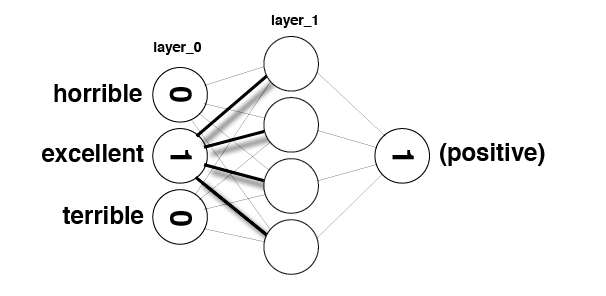

In [478]:
Image(filename='sentiment_network_sparse.png')

In [479]:
def get_most_similar_words(focus = "horrible"):
    most_similar = Counter()

    for word in mlp_full.word2index.keys():
        most_similar[word] = np.dot(mlp_full.weights_0_1[mlp_full.word2index[word]],mlp_full.weights_0_1[mlp_full.word2index[focus]])
    
    return most_similar.most_common()

In [481]:
get_most_similar_words("excellent")

[('excellent', 0.14583728669583068),
 ('perfect', 0.1240615907099486),
 ('great', 0.1062155985903608),
 ('amazing', 0.10158925120079088),
 ('wonderful', 0.095446468778476),
 ('best', 0.0939745417547692),
 ('today', 0.0897823113406305),
 ('fun', 0.08608196356693354),
 ('loved', 0.07910799805364557),
 ('superb', 0.07532964941161963),
 ('definitely', 0.07499006072265518),
 ('liked', 0.07348863625203197),
 ('highly', 0.07337102613300411),
 ('favorite', 0.07312319142897225),
 ('enjoyable', 0.07137462411593382),
 ('fantastic', 0.07055595303703893),
 ('enjoyed', 0.07012283732774967),
 ('job', 0.07003661213509998),
 ('brilliant', 0.06976080566480021),
 ('beautiful', 0.06506444479177105),
 ('perfectly', 0.06363166473031145),
 ('simple', 0.062021342339025294),
 ('bit', 0.06103461706689224),
 ('especially', 0.05912229701330672),
 ('very', 0.057983363397650506),
 ('rare', 0.05681703295376104),
 ('incredible', 0.05676473968553187),
 ('love', 0.05464937608797987),
 ('always', 0.05406199357958325),
 

In [482]:
get_most_similar_words("terrible")

[('worst', 0.17276875057076282),
 ('awful', 0.12358402440950611),
 ('waste', 0.11799294828333835),
 ('poor', 0.09962703944011515),
 ('boring', 0.09531719307204048),
 ('terrible', 0.09504079517561873),
 ('bad', 0.0806611582951095),
 ('dull', 0.08033075123115148),
 ('worse', 0.07405633066651918),
 ('poorly', 0.07400045898707569),
 ('stupid', 0.07342736793274748),
 ('annoying', 0.0733721033202578),
 ('unfortunately', 0.07195775097358749),
 ('disappointing', 0.07092984905301647),
 ('nothing', 0.06930694704077495),
 ('fails', 0.06928559275314806),
 ('horrible', 0.06582172819135823),
 ('mess', 0.06482949344135353),
 ('disappointment', 0.06451998422903095),
 ('supposed', 0.06174210575010309),
 ('badly', 0.060260634452559504),
 ('save', 0.059418074388339265),
 ('ridiculous', 0.05926805134782728),
 ('wasted', 0.059158859512065884),
 ('oh', 0.05728611735650153),
 ('minutes', 0.05709133221668648),
 ('avoid', 0.05642779174190782),
 ('crap', 0.05630775908441557),
 ('script', 0.056276271000059774),


In [483]:
import matplotlib.colors as colors

words_to_visualize = list()
for word, ratio in pos_neg_ratios.most_common(500):
    if(word in mlp_full.word2index.keys()):
        words_to_visualize.append(word)
    
for word, ratio in list(reversed(pos_neg_ratios.most_common()))[0:500]:
    if(word in mlp_full.word2index.keys()):
        words_to_visualize.append(word)

In [484]:
pos = 0
neg = 0

colors_list = list()
vectors_list = list()
for word in words_to_visualize:
    if word in pos_neg_ratios.keys():
        vectors_list.append(mlp_full.weights_0_1[mlp_full.word2index[word]])
        if(pos_neg_ratios[word] > 0):
            pos+=1
            colors_list.append("#00ff00")
        else:
            neg+=1
            colors_list.append("#000000")

In [485]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=0)
words_top_ted_tsne = tsne.fit_transform(vectors_list)

ModuleNotFoundError: No module named 'sklearn'

In [ ]:
p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="vector T-SNE for most polarized words")

source = ColumnDataSource(data=dict(x1=words_top_ted_tsne[:,0],
                                    x2=words_top_ted_tsne[:,1],
                                    names=words_to_visualize,
                                    color=colors_list))

p.scatter(x="x1", y="x2", size=8, source=source, fill_color="color")

word_labels = LabelSet(x="x1", y="x2", text="names", y_offset=6,
                  text_font_size="8pt", text_color="#555555",
                  source=source, text_align='center')
p.add_layout(word_labels)

show(p)

# green indicates positive words, black indicates negative words